# Caption→Image Retrieval

В этом ноутбуке я создаю систему поиска картин по текстовому описанию для 5000 изображений из фиксированного сэмпла датасета WikiArt. Для поиска используется FAISS HNSW.

Мой предыдущий опыт (в частности, при работе над датасетом для YandexART из нескольких десятков миллионов изображений, требующих подписи) показал, что проприетарные модели вроде GPT-4V дают наилучшие результаты, но их использование в этом проекте невозможно - во, первых, у меня нет стабильного GPT API, а во-вторых (что более важно для потенциального масштабирования), невозможно подписывать десятки тысяч изображений через проприетарные модели.

Современные open-source аналоги, такие как LLaVA или [ShareGPT4V](https://sharegpt4v.github.io/), могут не уместиться в 15 Гб VRAM.

Оригинальная модель BLIP, хоть и быстрая и маленькая (± 1Гб файлового веса), но уступает в качестве.

Поэтому в качестве модели для подписей я выбрала [BLIP2](https://huggingface.co/papers/2301.12597) c 4битной квантизацией. Она превосходит BLIP по качеству и требует не сильно больше ресурсов.

In [1]:
# Установка необходимых библиотек
%pip install -q datasets torch torchvision transformers open-clip-torch faiss-cpu pillow numpy pandas matplotlib tqdm huggingface-hub sentence-transformers


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 31.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.4/31.4 MB 79.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.7 MB/s eta 0:00:00


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import torch
from transformers import AutoProcessor, Blip2ForConditionalGeneration, BitsAndBytesConfig
from datasets import load_dataset, Dataset
import faiss
from tqdm.auto import tqdm
from tqdm.autonotebook import tqdm
import csv
import os
import requests
import warnings
import json
from PIL import Image
from sentence_transformers import SentenceTransformer
warnings.filterwarnings('ignore')

# from google.colab import drive
# drive.mount('/content/drive')

np.random.seed(42)
torch.manual_seed(42)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"{device=}")

device='cuda'


## Загрузка датасета


In [5]:
from huggingface_hub import notebook_login

notebook_login()

In [6]:
dataset = load_dataset("lyubachuba/wikiart_5k")

In [7]:
dataset = dataset['train']

### Загрузка модели BLIP-2


In [8]:
!pip install -q transformers bitsandbytes accelerate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 MB 10.8 MB/s eta 0:00:00


In [9]:
!pip install -U bitsandbytes

In [1]:
import torch
from transformers import AutoProcessor, Blip2ForConditionalGeneration, BitsAndBytesConfig

model_name = "Salesforce/blip2-opt-2.7b"

quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_compute_dtype=torch.float16,
    bnb_4bit_quant_type="nf4"
)

processor = AutoProcessor.from_pretrained(model_name)
model = Blip2ForConditionalGeneration.from_pretrained(
    model_name,
    quantization_config=quantization_config,
    device_map={"": 0}
)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.98G [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/10.0G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]


Процесс генерации caption с помощью BLIP-2:

- Изображение преобразуется в тензор нужного размера (384x384) и нормализуется
- Vision Transformer обрабатывает изображение и создает визуальные признаки
- Языковая модель генерирует описание на основе визуальных признаков
- Токены преобразуются обратно в текст

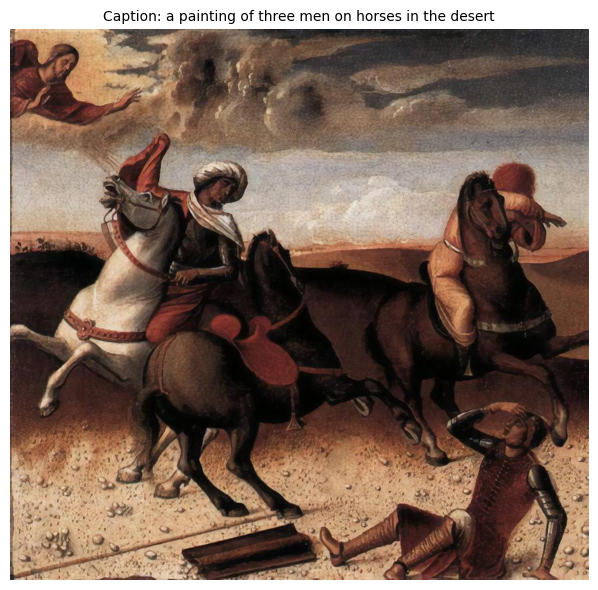

In [8]:
def generate_caption(image, processor, model, device, prompt="", max_length=75, num_beams=4):

    inputs = processor(images=image, text=prompt, return_tensors="pt").to(device, model.dtype)

    with torch.no_grad():
        output_ids = model.generate(
            **inputs,
            max_length=max_length,
            num_beams=num_beams,
            early_stopping=True
        )

    caption = processor.batch_decode(output_ids, skip_special_tokens=True)[0].strip()

    return caption


example_image = dataset[0]['image']
example_caption = generate_caption(example_image, processor, model, device)

plt.figure(figsize=(8, 6))
plt.imshow(example_image)
plt.title(f"Caption: {example_caption}", fontsize=10, wrap=True)
plt.axis('off')
plt.tight_layout()
plt.show()


## Примеры сгенерированных caption

In [9]:
import random

num_examples = 10
example_indices = random.sample([i for i in range(len(dataset))], 10)

example_captions = []

for idx in tqdm(example_indices):
    image = dataset[int(idx)]['image']
    caption = generate_caption(image, processor, model, device)
    example_captions.append({
        'index': int(idx),
        'image': image,
        'caption': caption
    })

  0%|          | 0/10 [00:00<?, ?it/s]

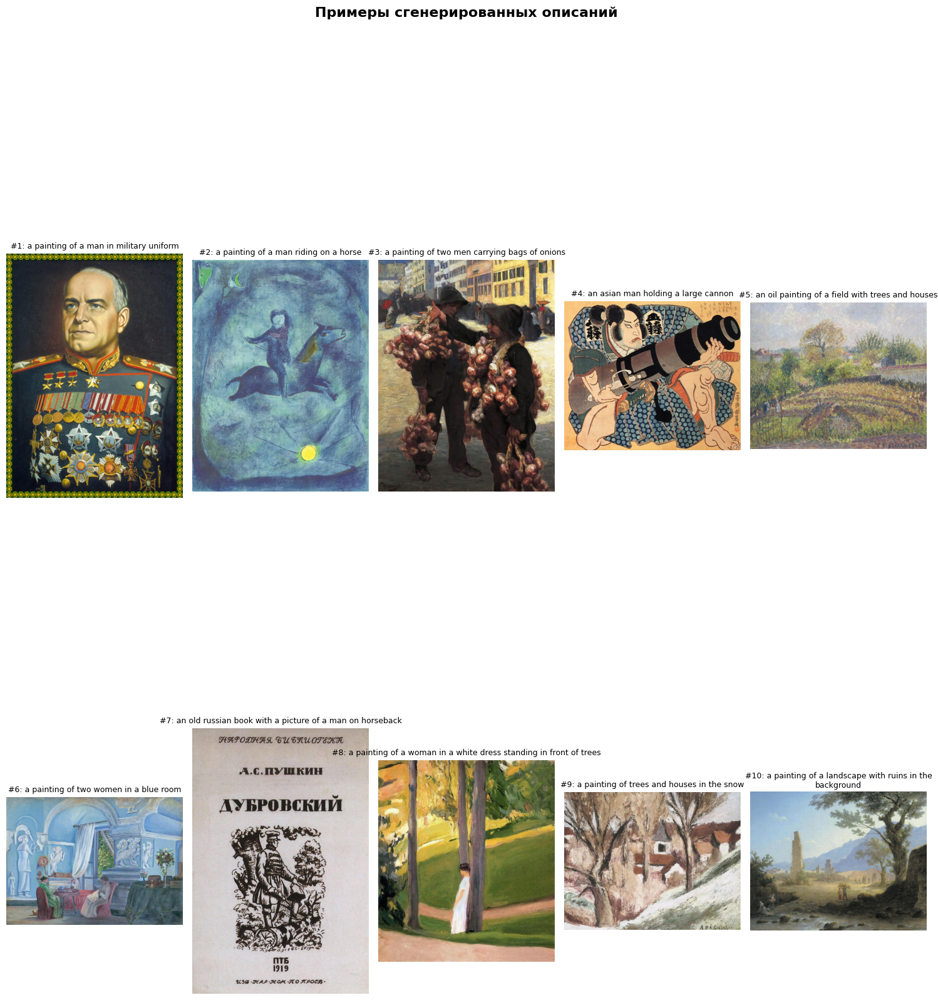

In [10]:
fig, axes = plt.subplots(2, 5, figsize=(15, 20))
fig.suptitle('Примеры сгенерированных описаний', fontsize=16, fontweight='bold')

for i, (ax, example) in enumerate(zip(axes.flat, example_captions)):
    ax.imshow(example['image'])
    caption_text = example['caption']
    if len(caption_text) > 80:
        caption_text = caption_text[:77] + '...'
    ax.set_title(f"#{i+1}: {caption_text}", fontsize=9, wrap=True)
    ax.axis('off')

plt.tight_layout()
plt.show()

## Генерация caption для всего датасета

In [13]:
all_captions = []
batch_size = 8

for i in tqdm(range(0, len(dataset), batch_size)):
    batch_end = min(i + batch_size, len(dataset))
    batch_images = [dataset[j]['image'] for j in range(i, batch_end)]

    for image in batch_images:
        caption = generate_caption(image, processor, model, device)
        all_captions.append(caption)

print(f"Примеры описаний:")
for i in range(5):
  print(f"{i+1}. {all_captions[i]}")


dataset_to_hf = [
    {
        'image_id': i,
        'caption': all_captions[i]
    } for i in range(len(all_captions))
]

dataset_to_hf = pd.DataFrame(dataset_to_hf)
dataset_to_hf = Dataset.from_pandas(dataset_to_hf)

dataset_to_hf.push_to_hub("lyubachuba/wikiart_5k_captions")

  0%|          | 0/625 [00:00<?, ?it/s]

Примеры описаний:
1. a painting of three men on horses in the desert
2. a painting of a woman holding a baby in front of a window
3. a painting of flowers in a vase
4. an image of a painting of a city at sunset
5. a painting of a beach with a person standing on the shore


Uploading the dataset shards:   0%|          | 0/1 [00:00<?, ? shards/s]

Creating parquet from Arrow format:   0%|          | 0/5 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              : 100%|##########|  118kB /  118kB            

CommitInfo(commit_url='https://huggingface.co/datasets/lyubachuba/wikiart_5k_captions/commit/0ee1dbbd5f31b34bd1dfb8b66e3095b53db182db', commit_message='Upload dataset', commit_description='', oid='0ee1dbbd5f31b34bd1dfb8b66e3095b53db182db', pr_url=None, repo_url=RepoUrl('https://huggingface.co/datasets/lyubachuba/wikiart_5k_captions', endpoint='https://huggingface.co', repo_type='dataset', repo_id='lyubachuba/wikiart_5k_captions'), pr_revision=None, pr_num=None)

Для поиска по описаниям буду использовать:

- **Sentence-BERT** для получения эмбеддингов текстов - all-mpnet-base-v2 небольшого размера и с [лучшим перформансом](https://www.sbert.net/docs/sentence_transformer/pretrained_models.html)
- **FAISS HNSW** для поиска ближайших соседей

In [12]:
# здесь заново выгружаю датасеты и соединяю кэпшны с картинками

captions = load_dataset("lyubachuba/wikiart_5k_captions")
dataset = load_dataset("lyubachuba/wikiart_5k")

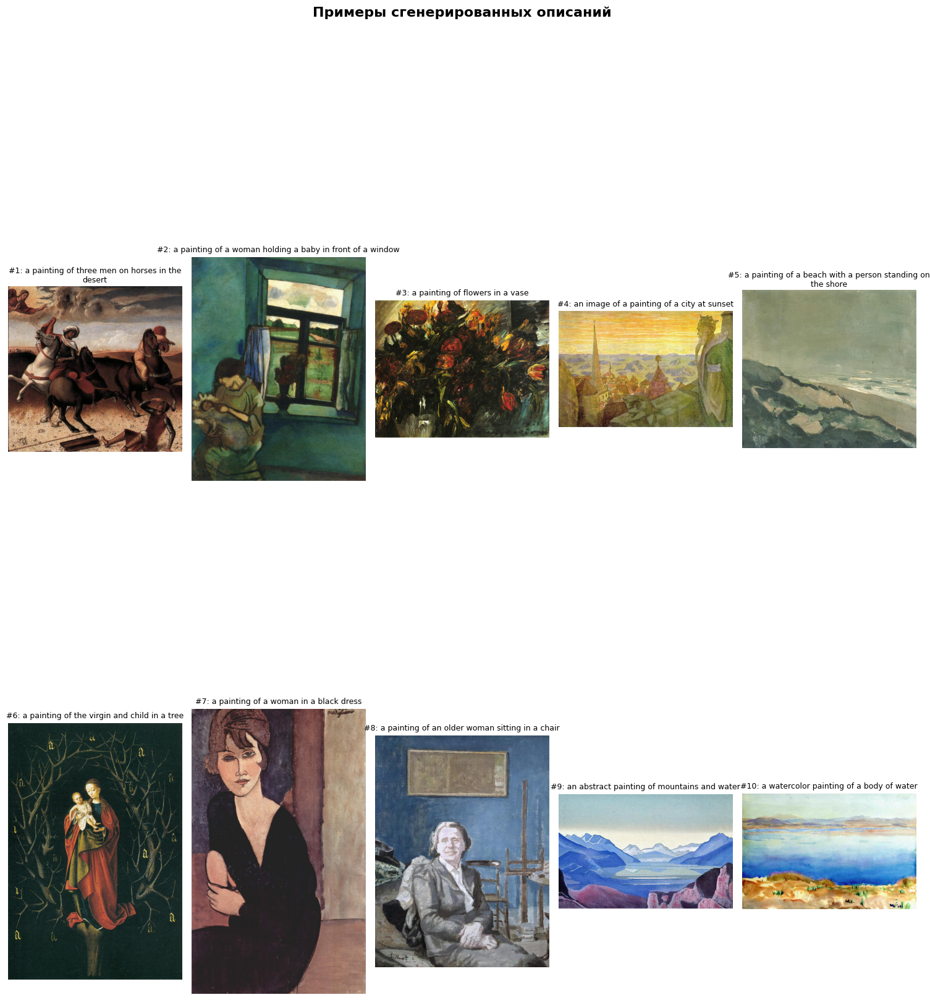

In [13]:
captions = captions['train']
dataset = dataset['train']

dataset = dataset.add_column('caption', captions['caption'])

fig, axes = plt.subplots(2, 5, figsize=(15, 20))
fig.suptitle('Примеры сгенерированных описаний', fontsize=16, fontweight='bold')

for i, (ax, example) in enumerate(zip(axes.flat, dataset)):
    ax.imshow(example['image'])
    caption_text = example['caption']
    if len(caption_text) > 80:
        caption_text = caption_text[:77] + '...'
    ax.set_title(f"#{i+1}: {caption_text}", fontsize=9, wrap=True)
    ax.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/5000 [00:00<?, ?it/s]

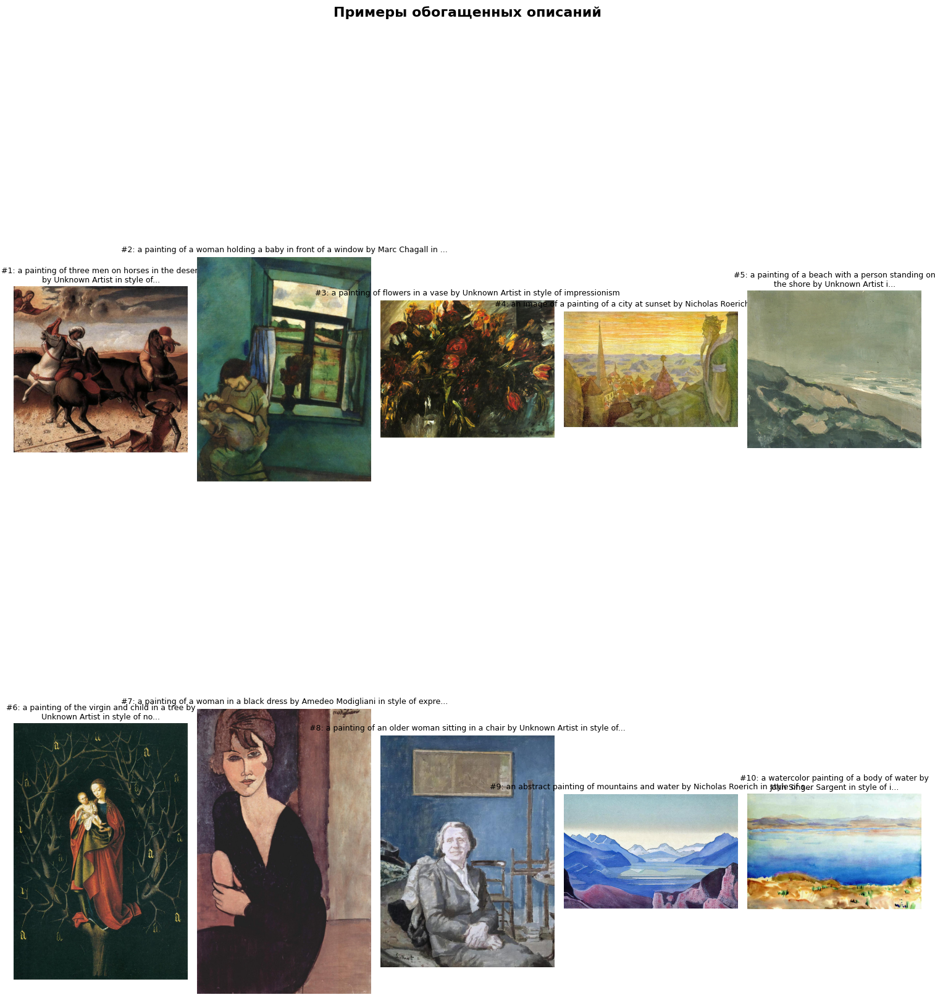

In [21]:
# и хочу обогатить кэпшны информацией о стиле и художнике

artists = dataset.features['artist'].names
styles = dataset.features['style'].names

extra_info_captions = []

for i in tqdm(range(len(dataset))):
    base_caption = dataset[i]['caption']
    artist = " ".join([elem.title() for elem in artists[dataset[i]['artist']].split("-")])
    style = " ".join([elem.lower() for elem in styles[dataset[i]['style']].split("_")])
    extra_info_captions.append(f"{base_caption} by {artist} in style of {style}")

dataset = dataset.add_column('enriched_caption', extra_info_captions)

fig, axes = plt.subplots(2, 5, figsize=(15, 20))
fig.suptitle('Примеры обогащенных описаний', fontsize=16, fontweight='bold')

for i, (ax, example) in enumerate(zip(axes.flat, dataset)):
    ax.imshow(example['image'])
    caption_text = example['enriched_caption']
    if len(caption_text) > 80:
        caption_text = caption_text[:77] + '...'
    ax.set_title(f"#{i+1}: {caption_text}", fontsize=9, wrap=True)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [23]:
sentence_encoder = SentenceTransformer('all-mpnet-base-v2', device=device)

caption_embeddings = sentence_encoder.encode(
    extra_info_captions,
    batch_size=32,
    show_progress_bar=True,
    convert_to_numpy=True
)

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/571 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/157 [00:00<?, ?it/s]

In [24]:
# нормализация для косинусного сходства
caption_embeddings = caption_embeddings / np.linalg.norm(
    caption_embeddings, axis=1, keepdims=True
)

In [25]:
caption_embeddings.shape

(5000, 768)

In [26]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [27]:
dimension = caption_embeddings.shape[1]
M = 32  # количество соседей

index = faiss.IndexHNSWFlat(dimension, M, faiss.METRIC_INNER_PRODUCT)
index.hnsw.efConstruction = 40
index.hnsw.efSearch = 16

index.add(caption_embeddings)

index_path = "/content/drive/MyDrive/MM_HW1/caption_index.bin"
faiss.write_index(index, index_path)


### Функции поиска по caption


In [43]:
import requests
from PIL import Image
import io
from matplotlib.gridspec import GridSpec


def search_similar_captions(query, sentence_processor, index, top_k=10):

    query_embedding = sentence_processor.encode([query], convert_to_numpy=True)
    query_embedding = query_embedding / np.linalg.norm(query_embedding, axis=1, keepdims=True)

    distances, indices = index.search(query_embedding.astype('float32'), top_k)

    return distances[0], indices[0]


def visualize_search_results(query_text, dataset, sentence_encoder, caption_index, top_k=10):
    distances, indices = search_similar_captions(query_text, sentence_encoder, caption_index, top_k)

    fig, axes = plt.subplots(2, 5, figsize=(25, 12))

    fig.suptitle(f'Поисковый запрос: "{query_text}"', fontsize=24, fontweight='bold')

    for i, (ax, result_idx) in enumerate(zip(axes.flat, indices)):
        found_item = dataset[int(result_idx)]
        result_image = found_item['image']
        similarity = distances[i]

        ax.imshow(result_image)
        ax.axis('off')

        caption = found_item.get('enriched_caption')

        short_caption = caption[:80]
        if len(caption) > 80:
            short_caption += "..."

        split_point = len(short_caption) // 2
        try:
            split_index = short_caption.rfind(' ', 0, split_point + 10)
            if split_index == -1: split_index = split_point
            line1 = short_caption[:split_index]
            line2 = short_caption[split_index+1:]
            title_caption = f"{line1}\n{line2}"
        except:
             title_caption = short_caption


        ax.set_title(
            f"#{i+1} | Сходство: {similarity:.3f}\n{title_caption}",
            fontsize=12,
            pad=10
        )

    for j in range(len(indices), len(axes.flat)):
        axes.flat[j].axis('off')

    plt.subplots_adjust(wspace=0.1, hspace=0.4)

    plt.show()




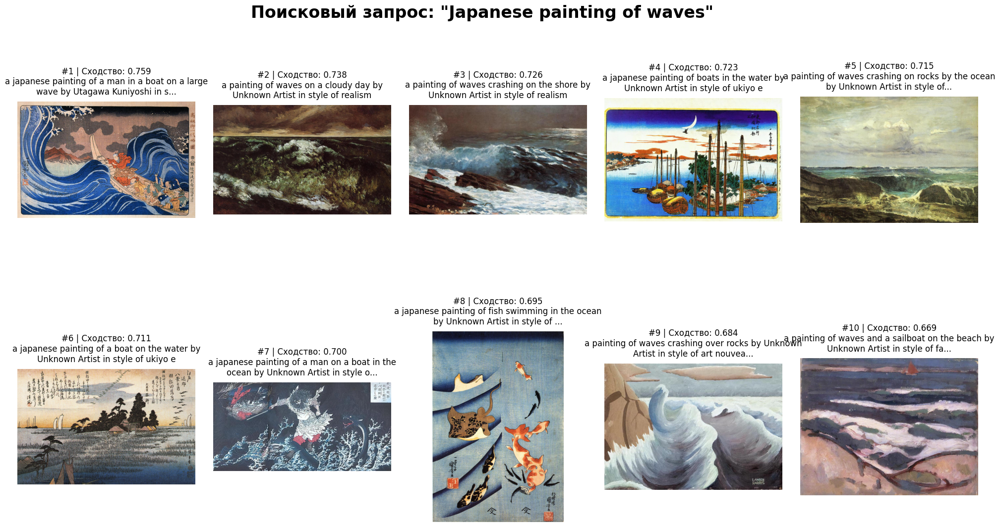

In [44]:
query_text = "Japanese painting of waves"
visualize_search_results(query_text, dataset, sentence_encoder, index)

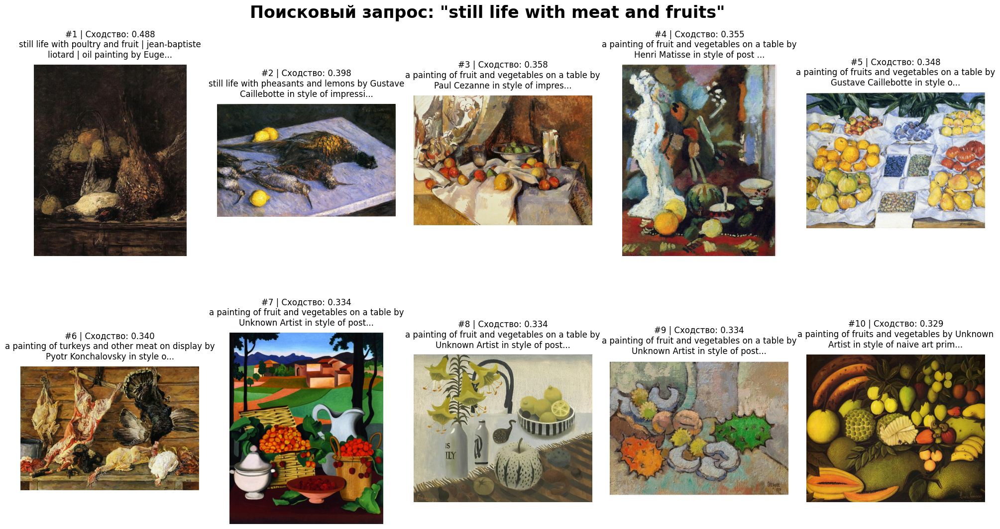

In [45]:
query_text = "still life with meat and fruits"
visualize_search_results(query_text, dataset, sentence_encoder, index)

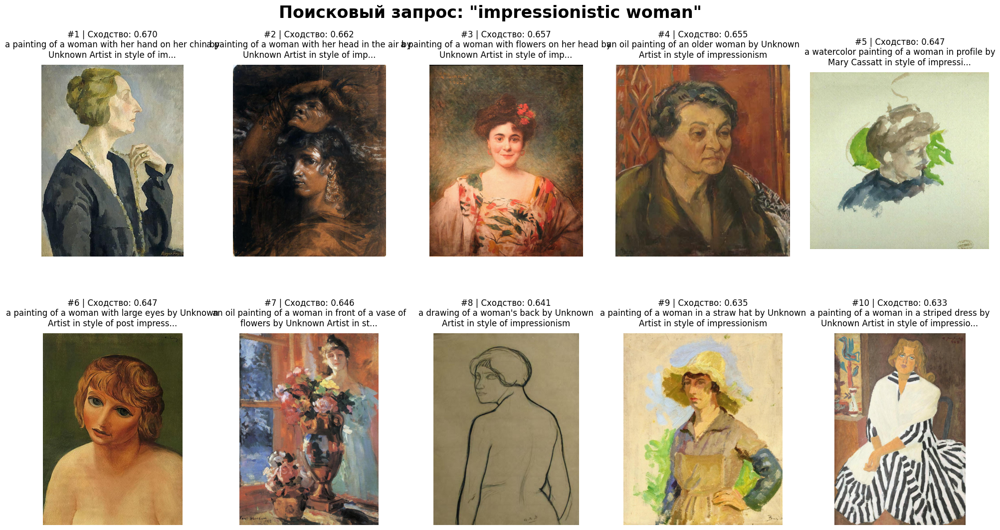

In [46]:
query_text = "impressionistic woman"
visualize_search_results(query_text, dataset, sentence_encoder, index)

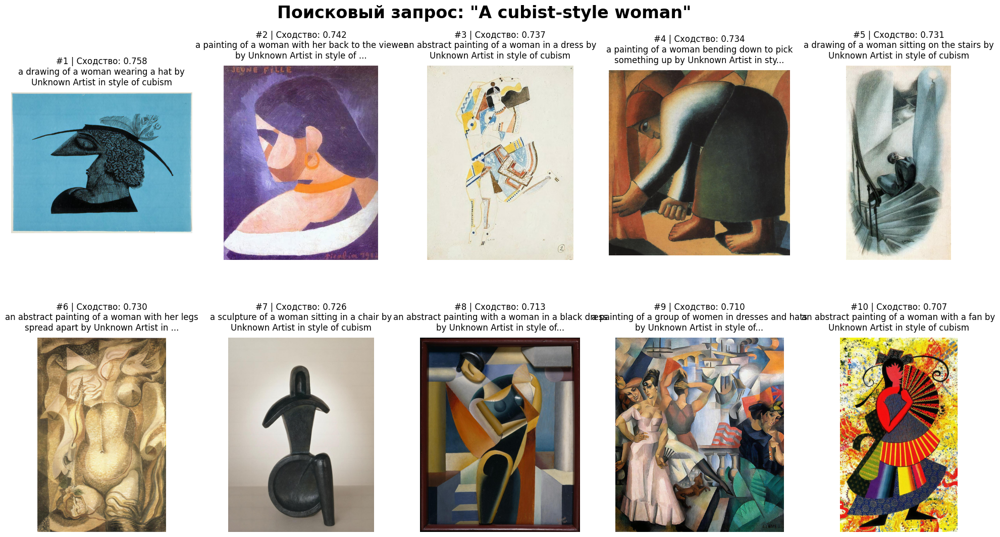

In [47]:
query_text = "A cubist-style woman"
visualize_search_results(query_text, dataset, sentence_encoder, index)

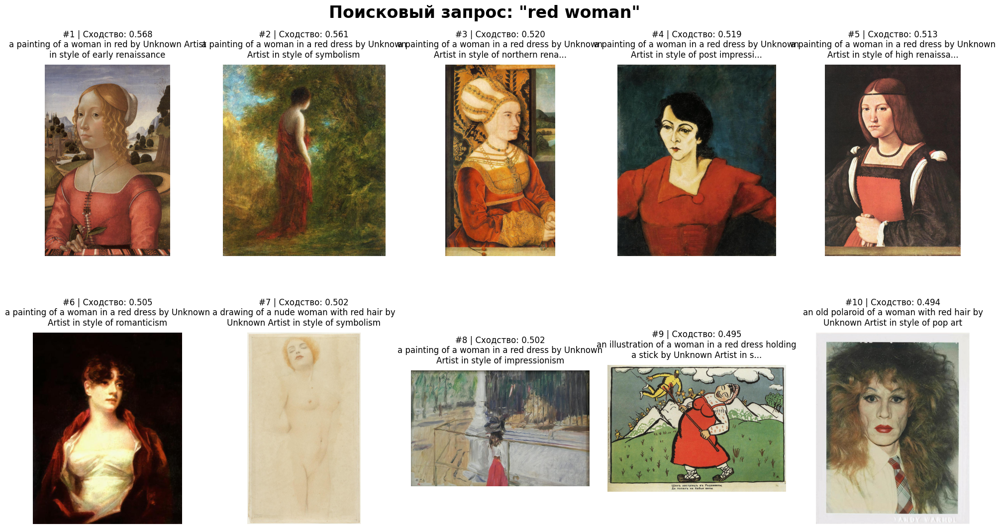

In [48]:
query_text = "red woman"
visualize_search_results(query_text, dataset, sentence_encoder, index)

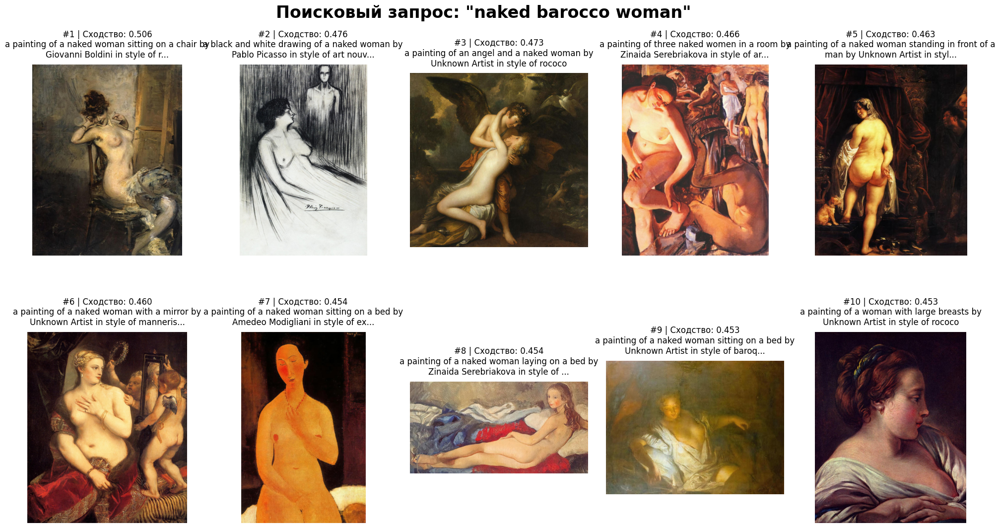

In [49]:
query_text = "naked barocco woman"
visualize_search_results(query_text, dataset, sentence_encoder, index)

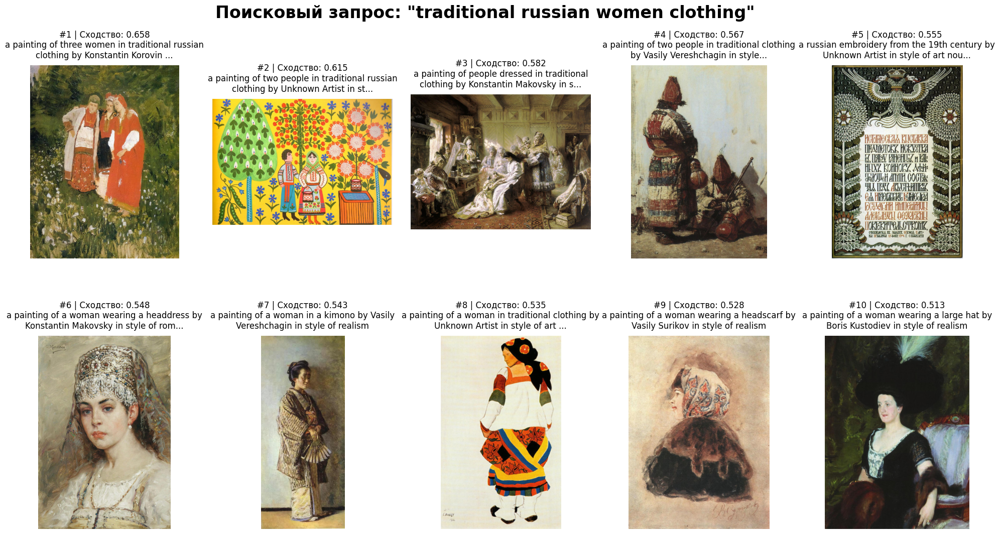

In [52]:
query_text = "traditional russian women clothing"
visualize_search_results(query_text, dataset, sentence_encoder, index)

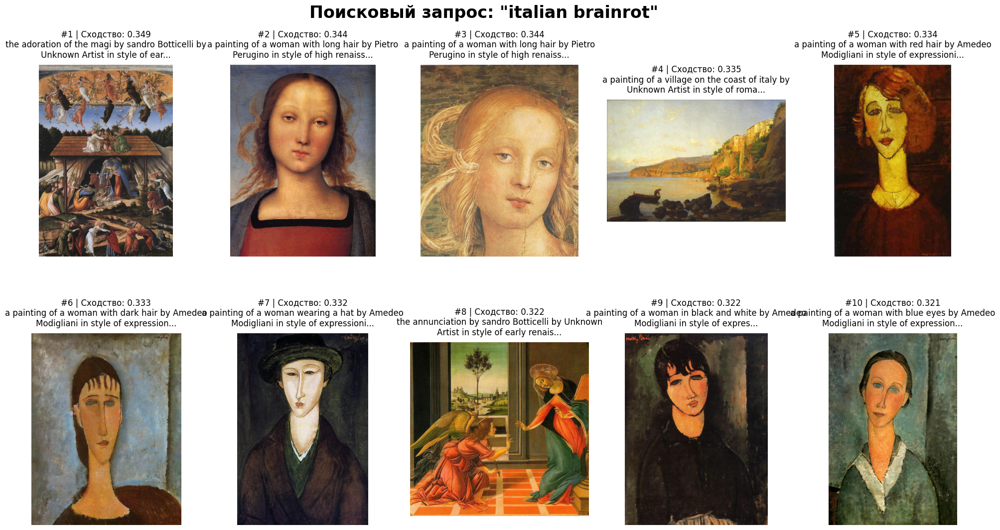

In [53]:
query_text = "italian brainrot"
visualize_search_results(query_text, dataset, sentence_encoder, index)

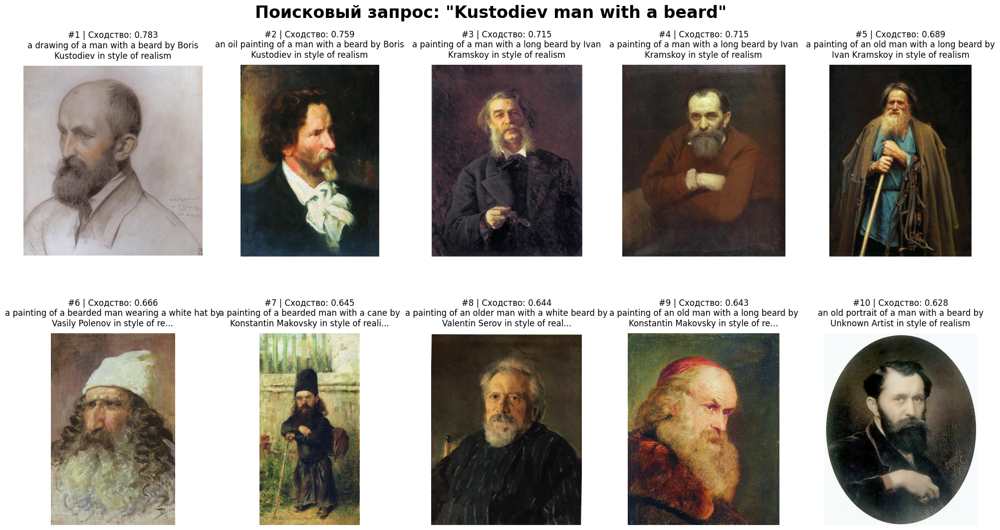

In [55]:
query_text = "Kustodiev man with a beard"
visualize_search_results(query_text, dataset, sentence_encoder, index)

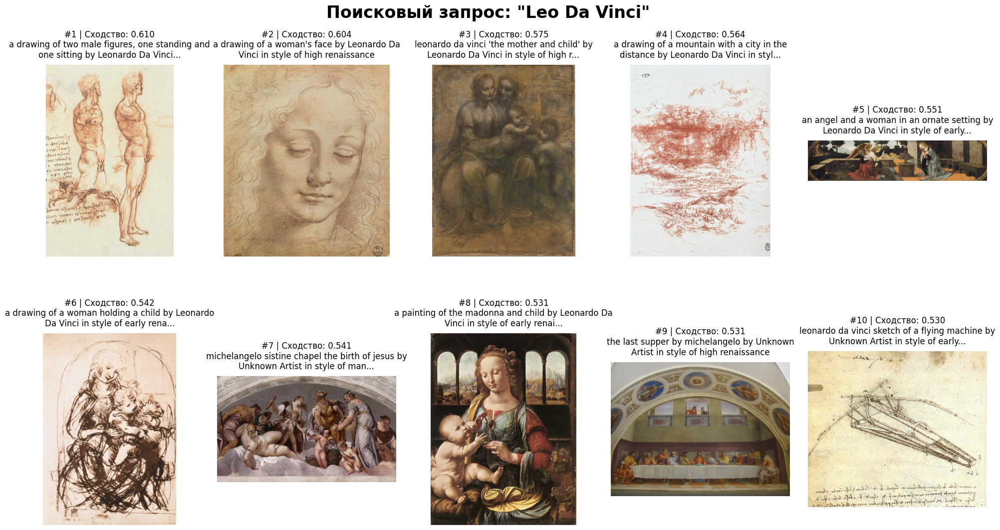

In [60]:
query_text = "Leo Da Vinci"
visualize_search_results(query_text, dataset, sentence_encoder, index)